## Import Modules

In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
import warnings
from tqdm.notebook import tqdm

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import load_img, array_to_img
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy

warnings.filterwarnings('ignore')

## Load the files

In [2]:
BASE_DIR = '/kaggle/input/anime-faces/data/'

In [3]:
# load complete image paths to the list
image_paths = []
for image_name in os.listdir(BASE_DIR):
    image_path = os.path.join(BASE_DIR, image_name)
    image_paths.append(image_path)

In [4]:
image_paths[:5]

['/kaggle/input/anime-faces/data/21130.png',
 '/kaggle/input/anime-faces/data/9273.png',
 '/kaggle/input/anime-faces/data/18966.png',
 '/kaggle/input/anime-faces/data/14127.png',
 '/kaggle/input/anime-faces/data/18054.png']

In [5]:
# remove unnecessary file
image_paths.remove('/kaggle/input/anime-faces/data/data')

In [6]:
len(image_paths)

21551

## Visualize the Image Dataset

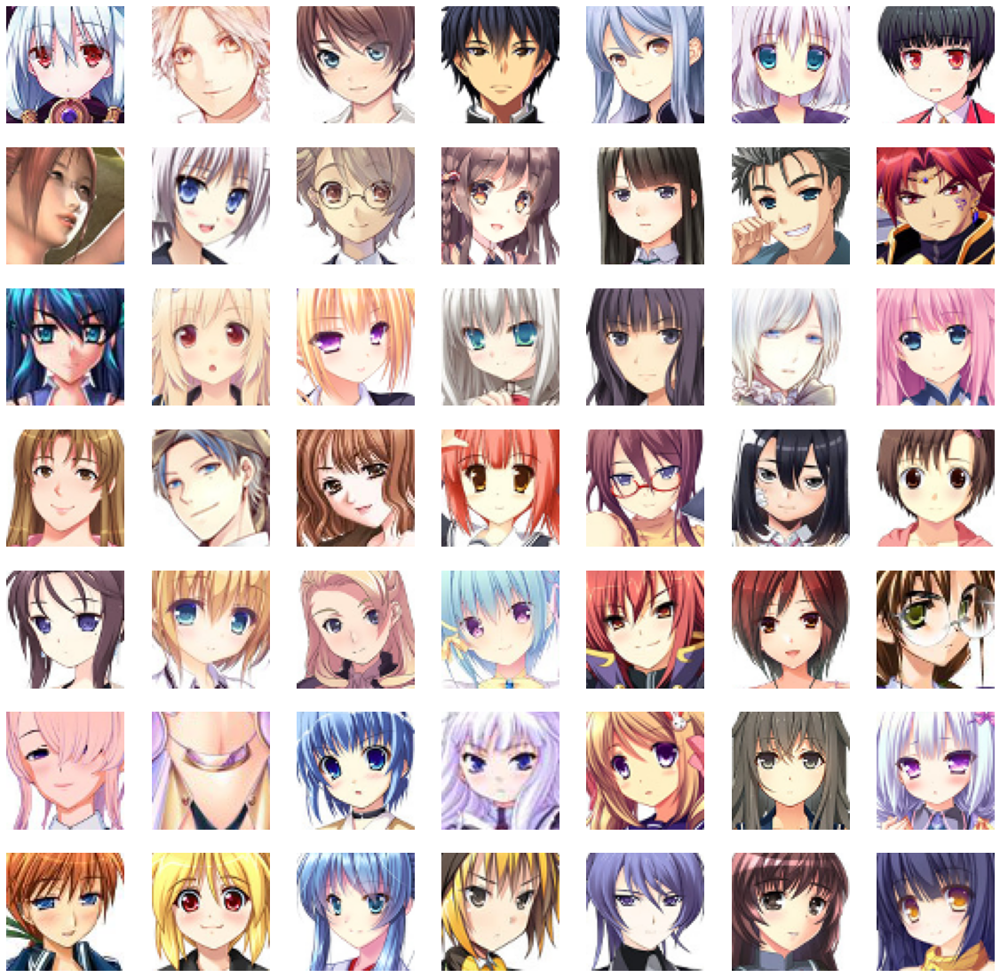

In [7]:
# to display grid of images (7x7)
plt.figure(figsize=(20, 20))
temp_images = image_paths[:49]
index = 1

for image_path in temp_images:
    plt.subplot(7, 7, index)
    # load the image
    img = load_img(image_path)
    # convert to numpy array
    img = np.array(img)
    # show the image
    plt.imshow(img)
    plt.axis('off')
    # increment the index for next image
    index += 1

## Preprocess Images

In [8]:
# load the image and convert to numpy array
train_images = [np.array(load_img(path)) for path in tqdm(image_paths)]
train_images = np.array(train_images)

  0%|          | 0/21551 [00:00<?, ?it/s]

In [9]:
train_images[0].shape

(64, 64, 3)

In [10]:
# reshape the array
train_images = train_images.reshape(train_images.shape[0], 64, 64, 3).astype('float32')

In [11]:
# normalize the images
train_images = (train_images - 127.5) / 127.5

In [12]:
train_images[0]

array([[[-0.7254902 , -0.90588236, -0.7176471 ],
        [-0.70980394, -0.88235295, -0.6862745 ],
        [-0.7019608 , -1.        , -0.7176471 ],
        ...,
        [-0.09019608,  0.01176471,  0.3882353 ],
        [-0.19215687,  0.05882353,  0.4509804 ],
        [-0.34117648, -0.13725491,  0.29411766]],

       [[-0.7254902 , -0.90588236, -0.7176471 ],
        [-0.73333335, -0.8666667 , -0.7019608 ],
        [-0.52156866, -0.8666667 , -0.5686275 ],
        ...,
        [-0.29411766,  0.01176471,  0.3019608 ],
        [-0.08235294,  0.15294118,  0.5294118 ],
        [-0.23921569,  0.09019608,  0.45882353]],

       [[-0.7019608 , -0.8901961 , -0.7019608 ],
        [-0.7176471 , -0.8745098 , -0.69411767],
        [-0.5686275 , -0.8509804 , -0.58431375],
        ...,
        [-0.22352941,  0.1764706 ,  0.48235294],
        [-0.13725491,  0.1764706 ,  0.4745098 ],
        [-0.06666667,  0.24705882,  0.5058824 ]],

       ...,

       [[-0.30980393, -0.6862745 , -0.29411766],
        [-0

## Create Generator & Discriminator Models

In [13]:
# latent dimension for random noise
LATENT_DIM = 100
# weight initializer
WEIGHT_INIT = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
# no. of channels of the image
CHANNELS = 3 # for gray scale, keep it as 1

### Generator Model

Generator Model will create new images similar to training data from random noise

In [14]:
model = Sequential(name='generator')

# 1d random noise
model.add(layers.Dense(8 * 8 * 512, input_dim=LATENT_DIM))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# convert 1d to 3d
model.add(layers.Reshape((8, 8, 512)))

# upsample to 16x16
model.add(layers.Conv2DTranspose(256, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# upsample to 32x32
model.add(layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# upsample to 64x64
model.add(layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

model.add(layers.Conv2D(CHANNELS, (4, 4), padding='same', activation='tanh'))

generator = model
generator.summary()

2023-02-08 02:24:22.261035: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-02-08 02:24:22.352832: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-02-08 02:24:22.353639: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-02-08 02:24:22.355500: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compil

Model: "generator"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 32768)             3309568   
_________________________________________________________________
re_lu (ReLU)                 (None, 32768)             0         
_________________________________________________________________
reshape (Reshape)            (None, 8, 8, 512)         0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 16, 16, 256)       2097408   
_________________________________________________________________
re_lu_1 (ReLU)               (None, 16, 16, 256)       0         
_________________________________________________________________
conv2d_transpose_1 (Conv2DTr (None, 32, 32, 128)       524416    
_________________________________________________________________
re_lu_2 (ReLU)               (None, 32, 32, 128)       0 

node zero
2023-02-08 02:24:24.522023: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-02-08 02:24:24.523055: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-02-08 02:24:24.523834: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-02-08 02:24:24.524488: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1510] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 15401 MB memory:  -> device: 0, name: Tesla P100-PCIE-16GB, pci bus id: 0000:00:04.0, compute capability: 6.0


### Discriminator Model

Discriminator model will classify the image from the generator to check whether it real (or) fake images.

In [15]:
model = Sequential(name='discriminator')
input_shape = (64, 64, 3)
alpha = 0.2

# create conv layers
model.add(layers.Conv2D(64, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Flatten())
model.add(layers.Dropout(0.3))

# output class
model.add(layers.Dense(1, activation='sigmoid'))

discriminator = model
discriminator.summary()

Model: "discriminator"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 32, 32, 64)        3136      
_________________________________________________________________
batch_normalization (BatchNo (None, 32, 32, 64)        256       
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 32, 32, 64)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 16, 16, 128)       131200    
_________________________________________________________________
batch_normalization_1 (Batch (None, 16, 16, 128)       512       
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 16, 16, 128)       0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 8, 8, 128)       

## Create DCGAN

In [16]:
class DCGAN(keras.Model):
    def __init__(self, generator, discriminator, latent_dim):
        super().__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dim = latent_dim
        self.g_loss_metric = keras.metrics.Mean(name='g_loss')
        self.d_loss_metric = keras.metrics.Mean(name='d_loss')
        
    @property
    def metrics(self):
        return [self.g_loss_metric, self.d_loss_metric]
    
    def compile(self, g_optimizer, d_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn
        
    def train_step(self, real_images):
        # get batch size from the data
        batch_size = tf.shape(real_images)[0]
        # generate random noise
        random_noise = tf.random.normal(shape=(batch_size, self.latent_dim))
        
        # train the discriminator with real (1) and fake (0) images
        with tf.GradientTape() as tape:
            # compute loss on real images
            pred_real = self.discriminator(real_images, training=True)
            # generate real image labels
            real_labels = tf.ones((batch_size, 1))
            # label smoothing
            real_labels += 0.05 * tf.random.uniform(tf.shape(real_labels))
            d_loss_real = self.loss_fn(real_labels, pred_real)
            
            # compute loss on fake images
            fake_images = self.generator(random_noise)
            pred_fake = self.discriminator(fake_images, training=True)
            # generate fake labels
            fake_labels = tf.zeros((batch_size, 1))
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)
            
            # total discriminator loss
            d_loss = (d_loss_real + d_loss_fake) / 2
            
        # compute discriminator gradients
        gradients = tape.gradient(d_loss, self.discriminator.trainable_variables)
        # update the gradients
        self.d_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))
        
        
        # train the generator model
        labels = tf.ones((batch_size, 1))
        # generator want discriminator to think that fake images are real
        with tf.GradientTape() as tape:
            # generate fake images from generator
            fake_images = self.generator(random_noise, training=True)
            # classify images as real or fake
            pred_fake = self.discriminator(fake_images, training=True)
            # compute loss
            g_loss = self.loss_fn(labels, pred_fake)
            
        # compute gradients
        gradients = tape.gradient(g_loss, self.generator.trainable_variables)
        # update the gradients
        self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))
        
        # update states for both models
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)
        
        return {'d_loss': self.d_loss_metric.result(), 'g_loss': self.g_loss_metric.result()}

In [17]:
class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self, num_imgs=25, latent_dim=100):
        self.num_imgs = num_imgs
        self.latent_dim = latent_dim
        # create random noise for generating images
        self.noise = tf.random.normal([25, latent_dim])

    def on_epoch_end(self, epoch, logs=None):
        # generate the image from noise
        g_img = self.model.generator(self.noise)
        # denormalize the image
        g_img = (g_img * 127.5) + 127.5
        g_img.numpy()
        
        fig = plt.figure(figsize=(8, 8))
        for i in range(self.num_imgs):
            plt.subplot(5, 5, i+1)
            img = array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')
        # plt.savefig('epoch_{:03d}.png'.format(epoch))
        plt.show()
        
    def on_train_end(self, logs=None):
        self.model.generator.save('generator.h5')

In [18]:
dcgan = DCGAN(generator=generator, discriminator=discriminator, latent_dim=LATENT_DIM)

In [19]:
D_LR = 0.0001 
G_LR = 0.0003
dcgan.compile(g_optimizer=Adam(learning_rate=G_LR, beta_1=0.5), d_optimizer=Adam(learning_rate=D_LR, beta_1=0.5), loss_fn=BinaryCrossentropy())

2023-02-08 02:24:25.158449: W tensorflow/core/framework/cpu_allocator_impl.cc:80] Allocation of 1059274752 exceeds 10% of free system memory.
2023-02-08 02:24:26.332743: W tensorflow/core/framework/cpu_allocator_impl.cc:80] Allocation of 1059274752 exceeds 10% of free system memory.
2023-02-08 02:24:27.173692: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)


Epoch 1/50


2023-02-08 02:24:29.703314: I tensorflow/stream_executor/cuda/cuda_dnn.cc:369] Loaded cuDNN version 8005


674/674 [==============================] - 36s 41ms/step - d_loss: 0.6092 - g_loss: 2.7299


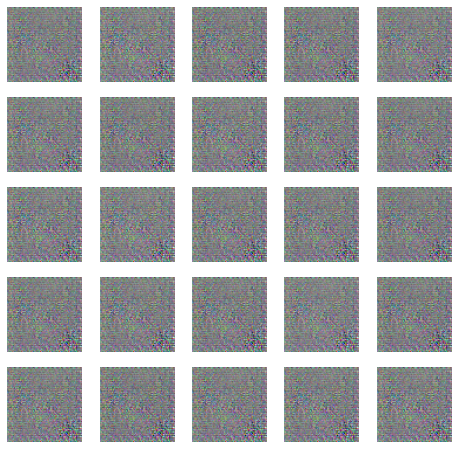

Epoch 2/50
674/674 [==============================] - 27s 41ms/step - d_loss: 0.5241 - g_loss: 1.9957


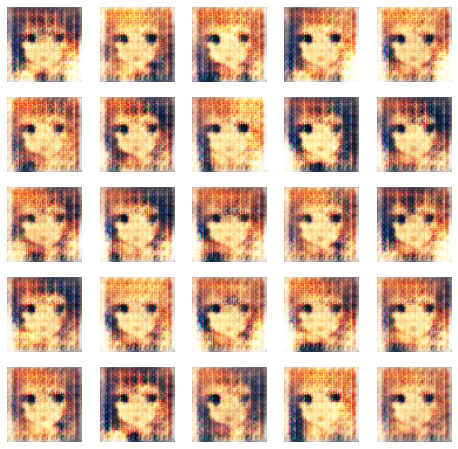

Epoch 3/50
674/674 [==============================] - 27s 41ms/step - d_loss: 0.5738 - g_loss: 1.8336


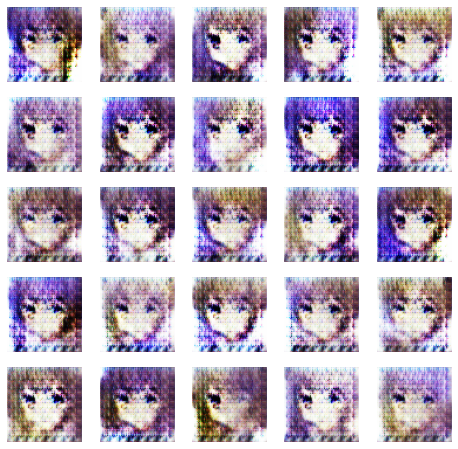

Epoch 4/50
674/674 [==============================] - 27s 41ms/step - d_loss: 0.5997 - g_loss: 1.7399


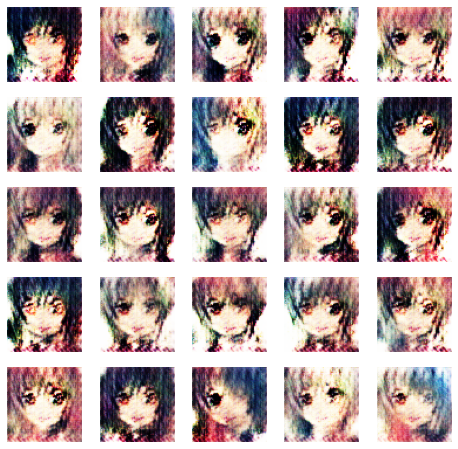

Epoch 5/50
674/674 [==============================] - 27s 41ms/step - d_loss: 0.6196 - g_loss: 1.6546


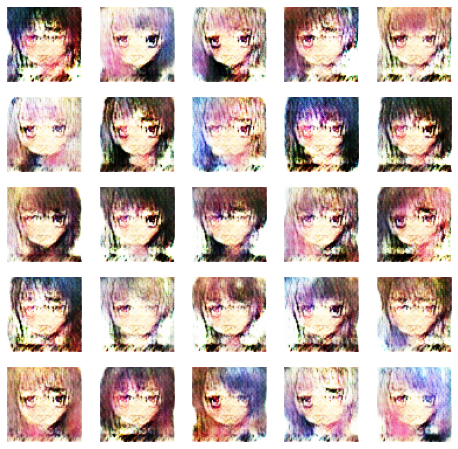

Epoch 6/50
674/674 [==============================] - 27s 41ms/step - d_loss: 0.5933 - g_loss: 1.5709


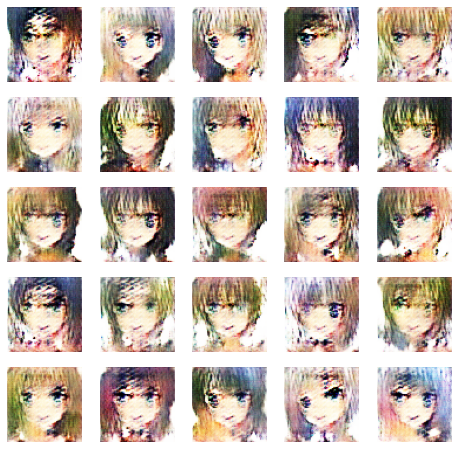

Epoch 7/50
674/674 [==============================] - 27s 41ms/step - d_loss: 0.6225 - g_loss: 1.3766


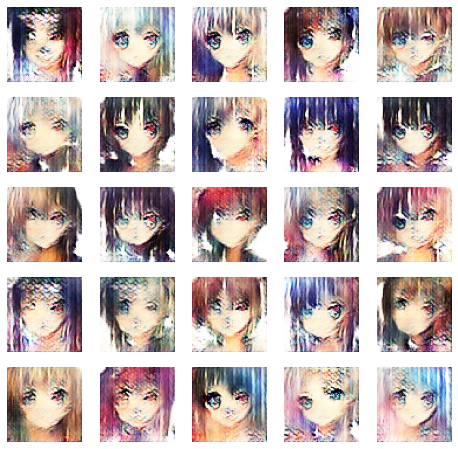

Epoch 8/50
674/674 [==============================] - 27s 41ms/step - d_loss: 0.6364 - g_loss: 1.2569


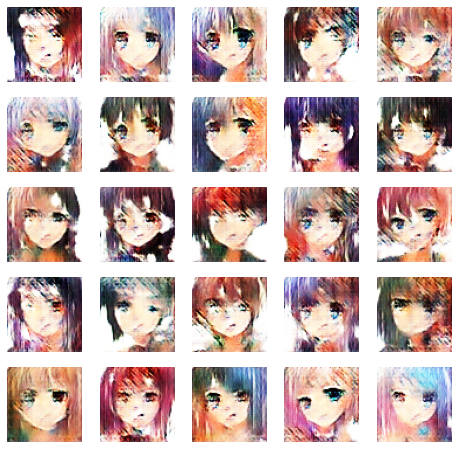

Epoch 9/50
674/674 [==============================] - 27s 41ms/step - d_loss: 0.6491 - g_loss: 1.1808


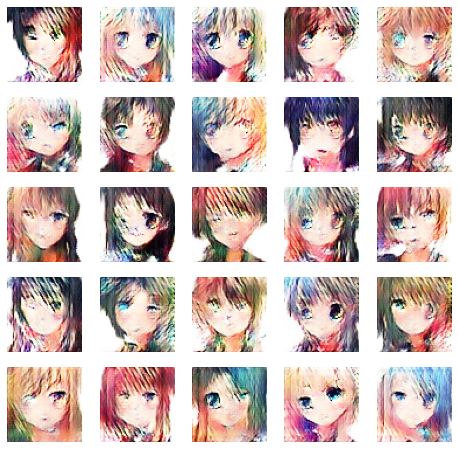

Epoch 10/50
674/674 [==============================] - 27s 40ms/step - d_loss: 0.6962 - g_loss: 1.0153


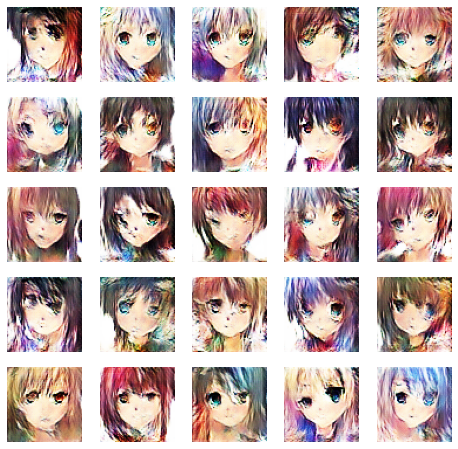

Epoch 11/50
674/674 [==============================] - 27s 41ms/step - d_loss: 0.7165 - g_loss: 0.9253


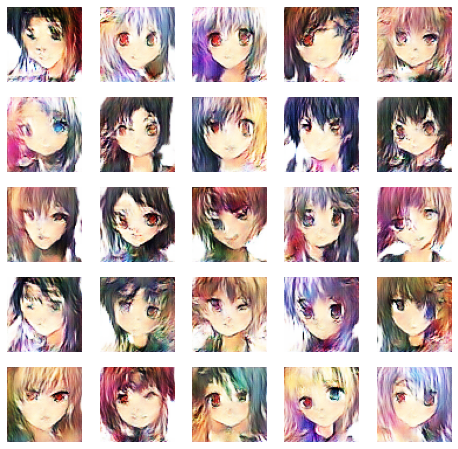

Epoch 12/50
674/674 [==============================] - 27s 41ms/step - d_loss: 0.7209 - g_loss: 0.8608


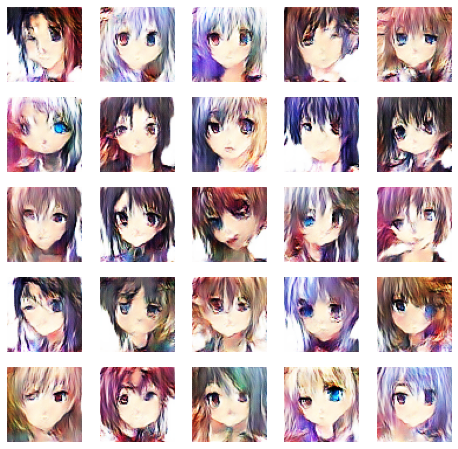

Epoch 13/50
674/674 [==============================] - 28s 41ms/step - d_loss: 0.7201 - g_loss: 0.8332


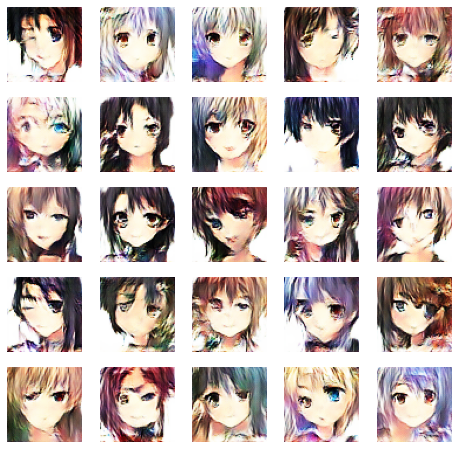

Epoch 14/50
674/674 [==============================] - 28s 41ms/step - d_loss: 0.7134 - g_loss: 0.8114


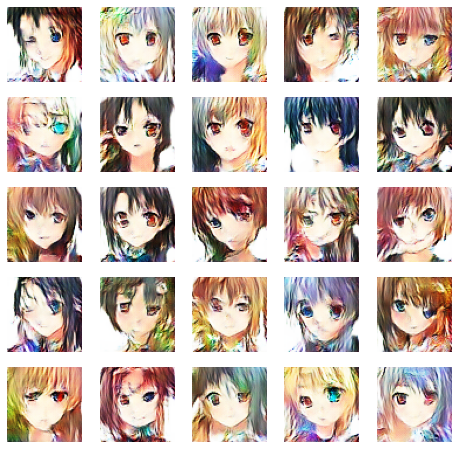

Epoch 15/50
674/674 [==============================] - 28s 41ms/step - d_loss: 0.7064 - g_loss: 0.8128


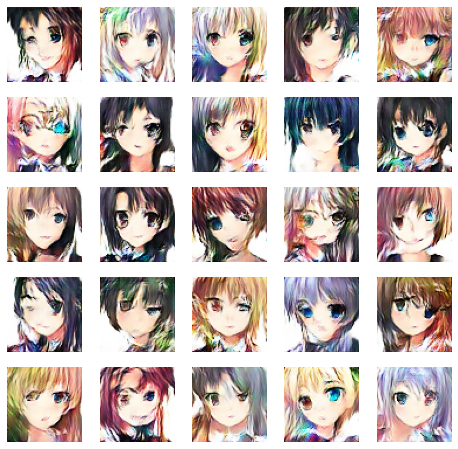

Epoch 16/50
674/674 [==============================] - 27s 41ms/step - d_loss: 0.7044 - g_loss: 0.8055


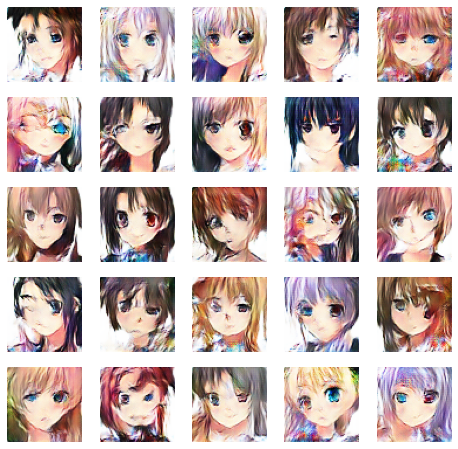

Epoch 17/50
674/674 [==============================] - 28s 41ms/step - d_loss: 0.7050 - g_loss: 0.7948


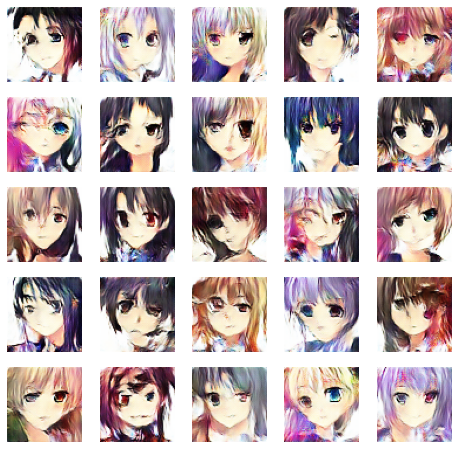

Epoch 18/50
674/674 [==============================] - 27s 41ms/step - d_loss: 0.7024 - g_loss: 0.7843


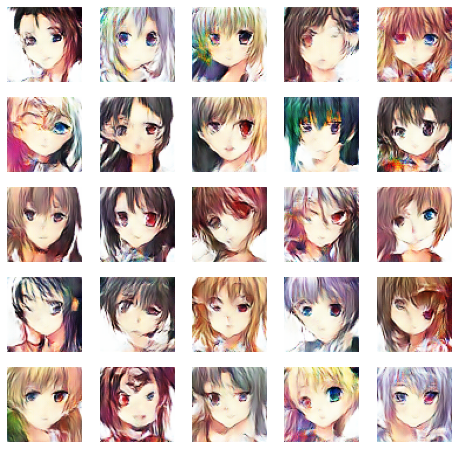

Epoch 19/50
674/674 [==============================] - 27s 41ms/step - d_loss: 0.7033 - g_loss: 0.7805


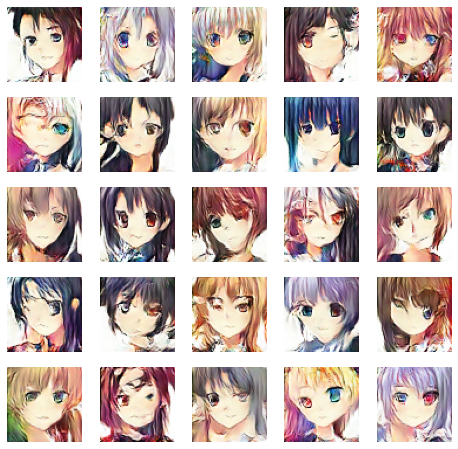

Epoch 20/50
674/674 [==============================] - 27s 41ms/step - d_loss: 0.7027 - g_loss: 0.7699


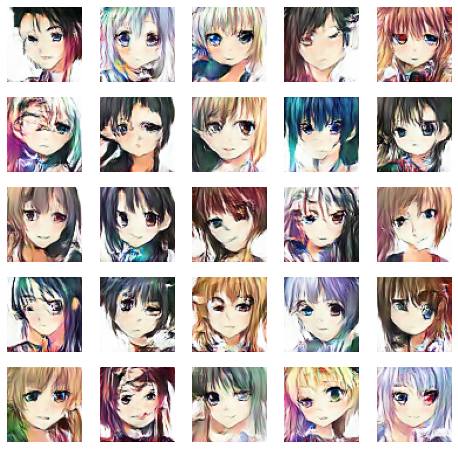

Epoch 21/50
674/674 [==============================] - 28s 41ms/step - d_loss: 0.6987 - g_loss: 0.7638


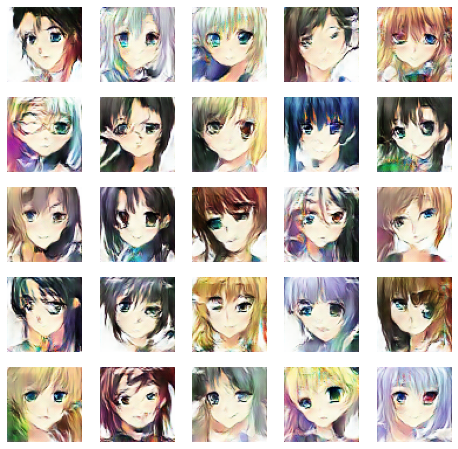

Epoch 22/50
674/674 [==============================] - 27s 41ms/step - d_loss: 0.6996 - g_loss: 0.7681


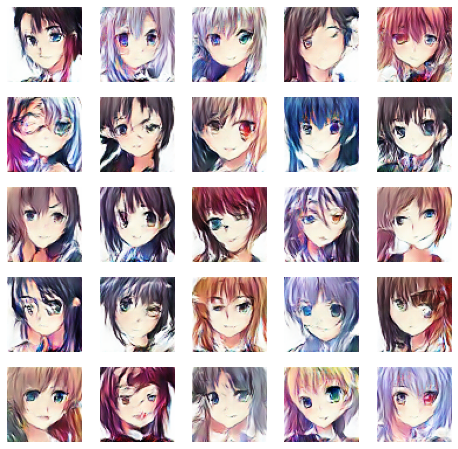

Epoch 23/50
674/674 [==============================] - 27s 41ms/step - d_loss: 0.6940 - g_loss: 0.7724


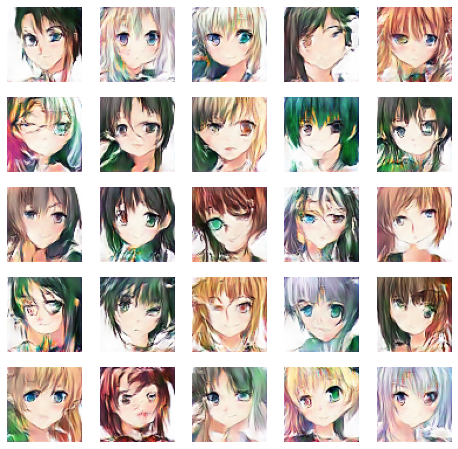

Epoch 24/50
674/674 [==============================] - 27s 40ms/step - d_loss: 0.6930 - g_loss: 0.7711


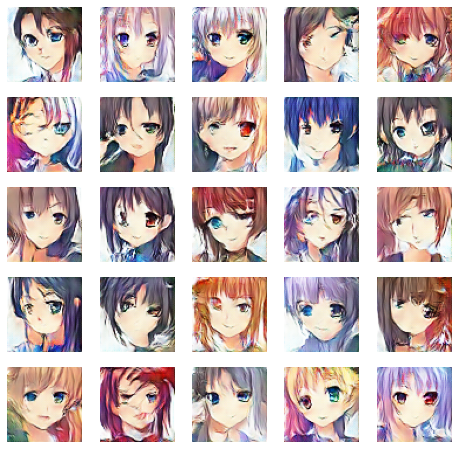

Epoch 25/50
674/674 [==============================] - 27s 41ms/step - d_loss: 0.6907 - g_loss: 0.7773


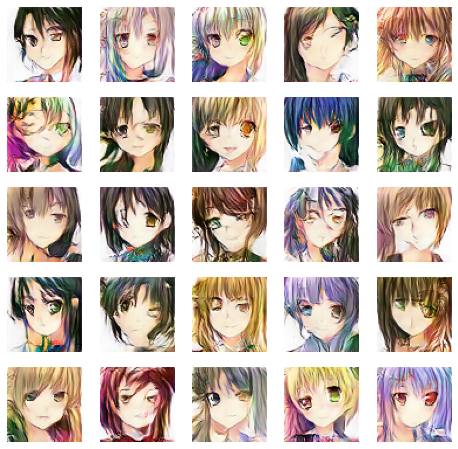

Epoch 26/50
674/674 [==============================] - 27s 41ms/step - d_loss: 0.6867 - g_loss: 0.7815


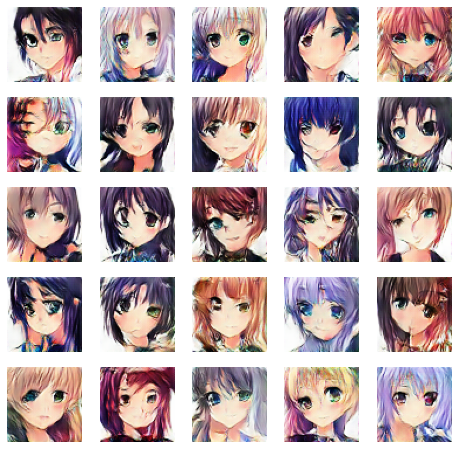

Epoch 27/50
674/674 [==============================] - 27s 40ms/step - d_loss: 0.6836 - g_loss: 0.7940


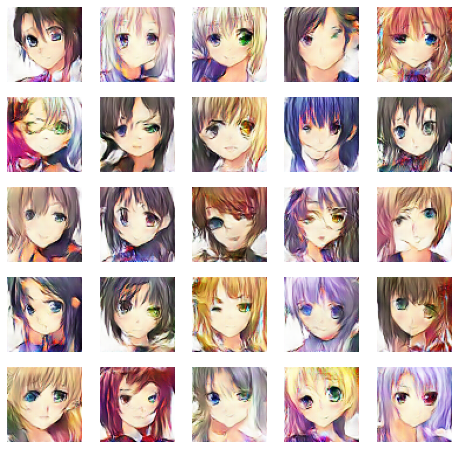

Epoch 28/50
674/674 [==============================] - 27s 41ms/step - d_loss: 0.6790 - g_loss: 0.8047


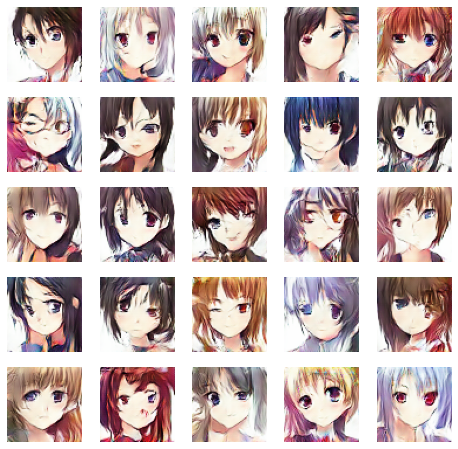

Epoch 29/50
674/674 [==============================] - 28s 41ms/step - d_loss: 0.6776 - g_loss: 0.8097


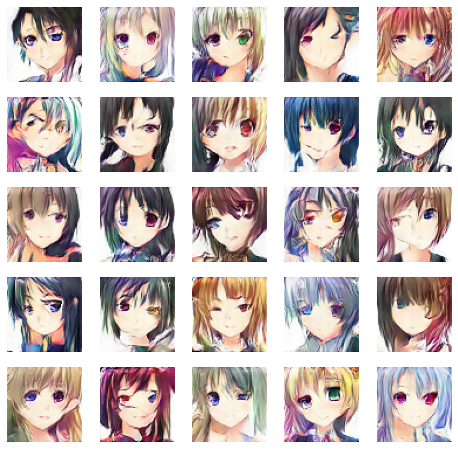

Epoch 30/50
674/674 [==============================] - 28s 41ms/step - d_loss: 0.6717 - g_loss: 0.8222


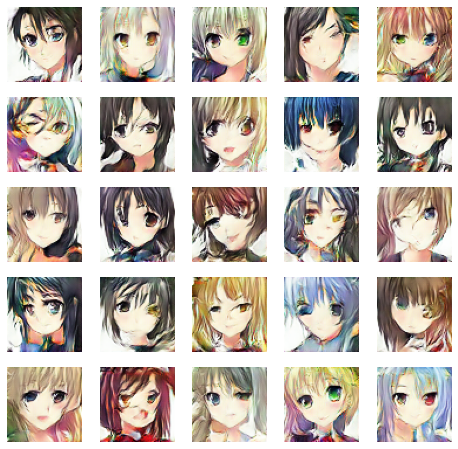

Epoch 31/50
674/674 [==============================] - 28s 41ms/step - d_loss: 0.6688 - g_loss: 0.8341


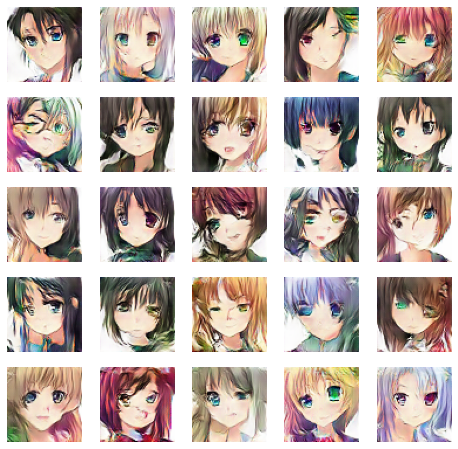

Epoch 32/50
674/674 [==============================] - 27s 41ms/step - d_loss: 0.6618 - g_loss: 0.8468


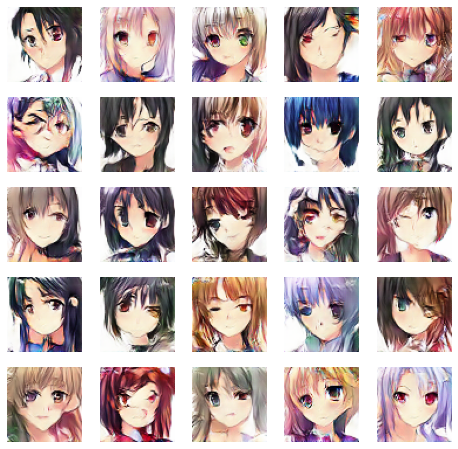

Epoch 33/50
674/674 [==============================] - 28s 41ms/step - d_loss: 0.6582 - g_loss: 0.8615


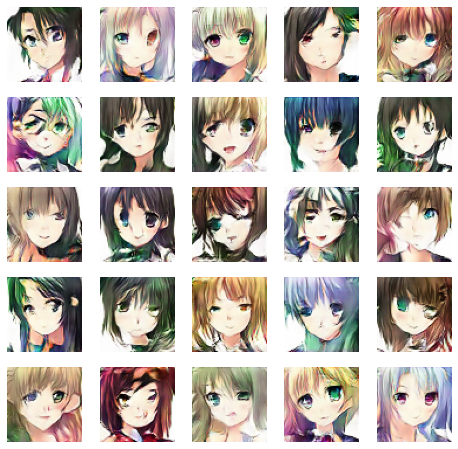

Epoch 34/50
674/674 [==============================] - 27s 40ms/step - d_loss: 0.6516 - g_loss: 0.8705


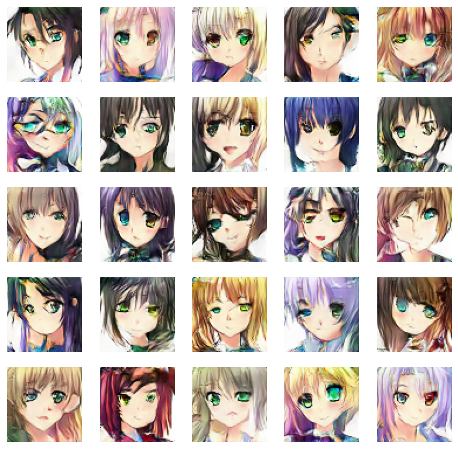

Epoch 35/50
674/674 [==============================] - 28s 41ms/step - d_loss: 0.6470 - g_loss: 0.8930


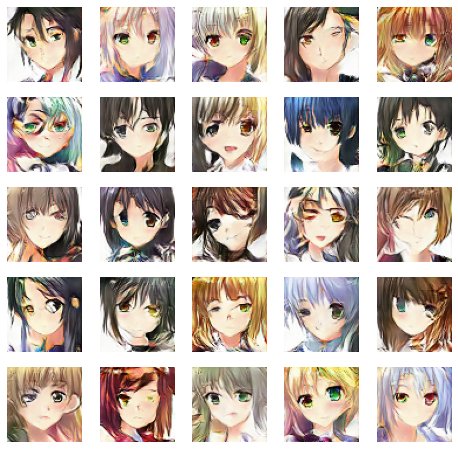

Epoch 36/50
674/674 [==============================] - 27s 41ms/step - d_loss: 0.6424 - g_loss: 0.9033


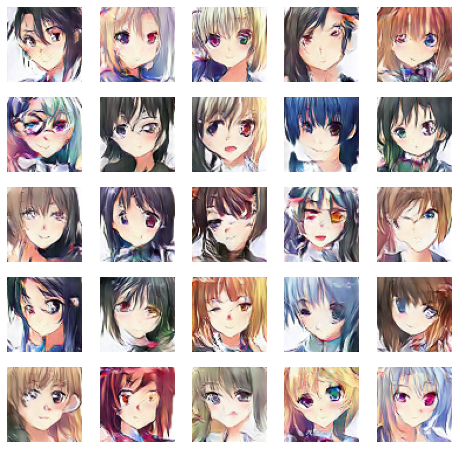

Epoch 37/50
674/674 [==============================] - 27s 41ms/step - d_loss: 0.6357 - g_loss: 0.9156


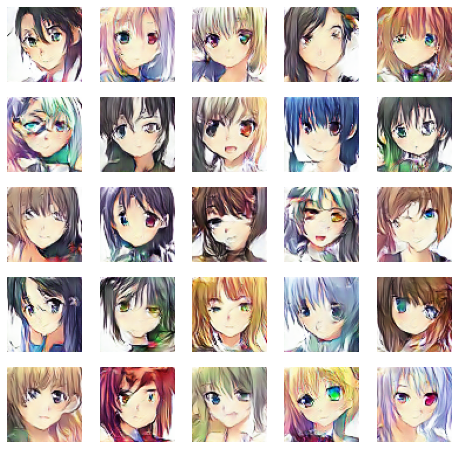

Epoch 38/50
674/674 [==============================] - 27s 41ms/step - d_loss: 0.6375 - g_loss: 0.9255


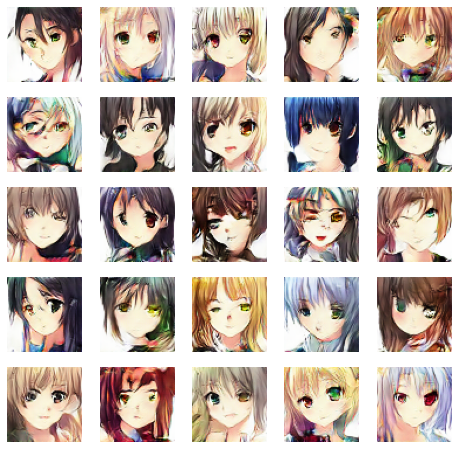

Epoch 39/50
674/674 [==============================] - 28s 41ms/step - d_loss: 0.6327 - g_loss: 0.9445


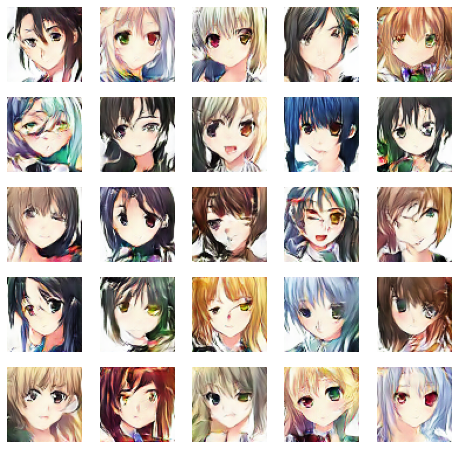

Epoch 40/50
674/674 [==============================] - 27s 40ms/step - d_loss: 0.6304 - g_loss: 0.9496


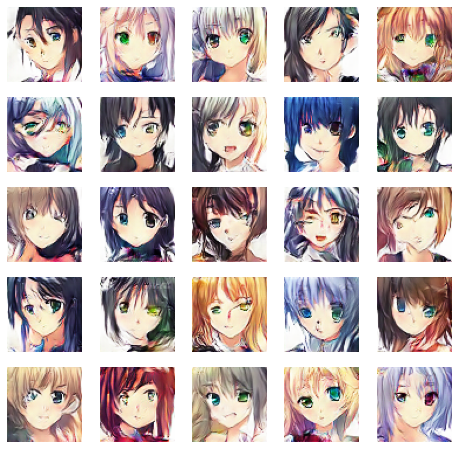

Epoch 41/50
674/674 [==============================] - 28s 41ms/step - d_loss: 0.6237 - g_loss: 0.9649


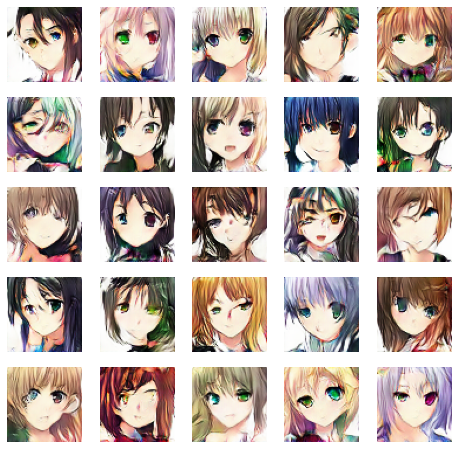

Epoch 42/50
674/674 [==============================] - 27s 40ms/step - d_loss: 0.6227 - g_loss: 0.9827


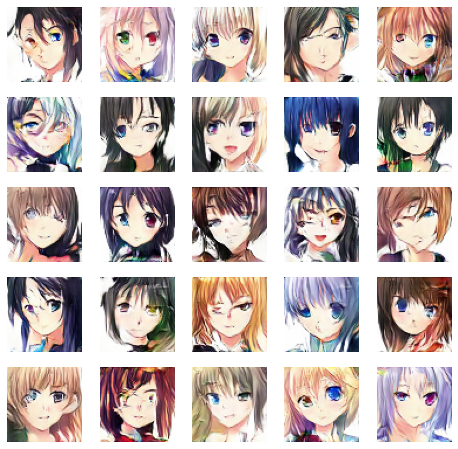

Epoch 43/50
674/674 [==============================] - 27s 41ms/step - d_loss: 0.6221 - g_loss: 0.9904


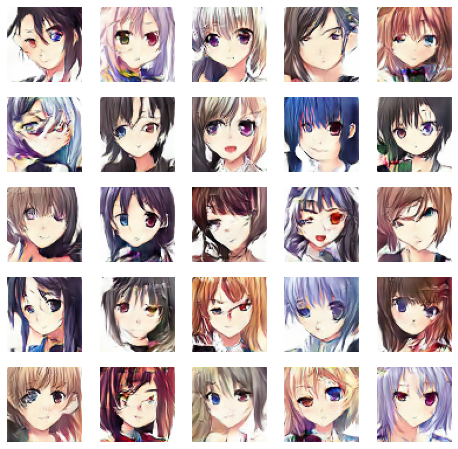

Epoch 44/50
674/674 [==============================] - 27s 40ms/step - d_loss: 0.6144 - g_loss: 0.9968


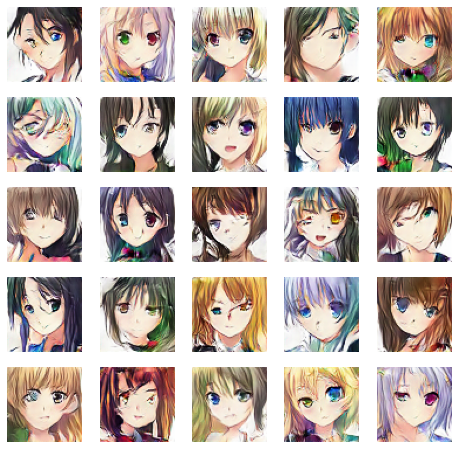

Epoch 45/50
674/674 [==============================] - 28s 41ms/step - d_loss: 0.6125 - g_loss: 1.0184


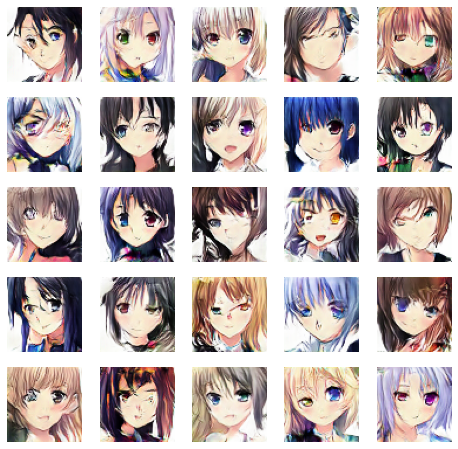

Epoch 46/50
674/674 [==============================] - 27s 41ms/step - d_loss: 0.6076 - g_loss: 1.0264


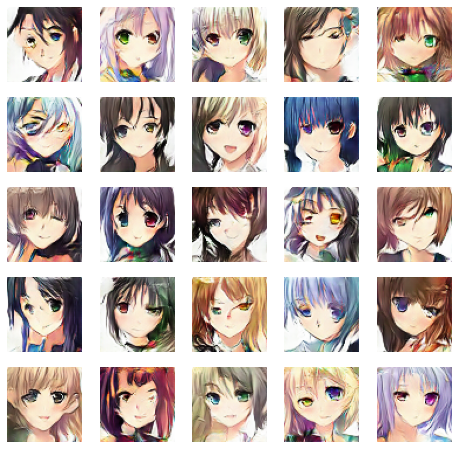

Epoch 47/50
674/674 [==============================] - 27s 41ms/step - d_loss: 0.6028 - g_loss: 1.0532


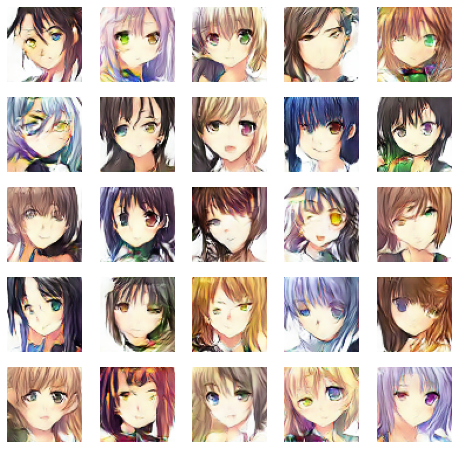

Epoch 48/50
674/674 [==============================] - 27s 40ms/step - d_loss: 0.5999 - g_loss: 1.0589


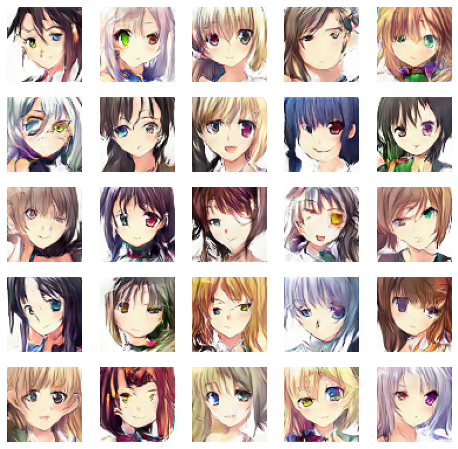

Epoch 49/50
674/674 [==============================] - 27s 41ms/step - d_loss: 0.5981 - g_loss: 1.0709


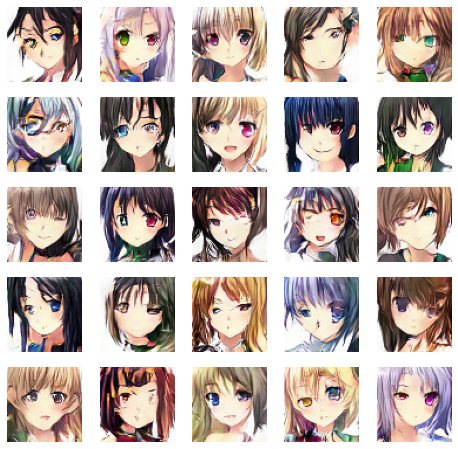

Epoch 50/50
674/674 [==============================] - 27s 40ms/step - d_loss: 0.5894 - g_loss: 1.0865


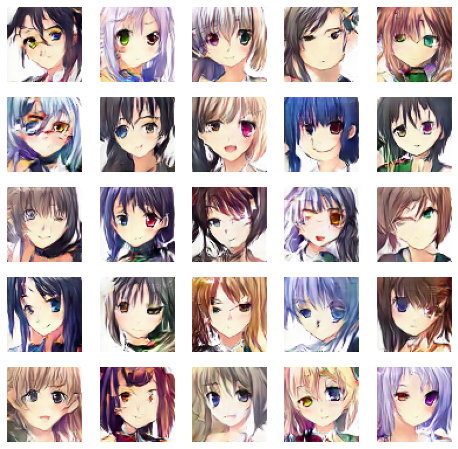

In [20]:
N_EPOCHS = 50
dcgan.fit(train_images, epochs=N_EPOCHS, callbacks=[DCGANMonitor()])

## Generate New Anime Image

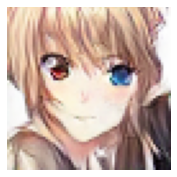

In [38]:
noise = tf.random.normal([1, 100])
fig = plt.figure(figsize=(3, 3))
# generate the image from noise
g_img = dcgan.generator(noise)
# denormalize the image
g_img = (g_img * 127.5) + 127.5
g_img.numpy()
img = array_to_img(g_img[0])
plt.imshow(img)
plt.axis('off')
# plt.savefig('epoch_{:03d}.png'.format(epoch))
plt.show()